In [41]:
import matplotlib.pylab as plt
import jax.numpy as jnp
import numpy as np
from desc.grid import Grid, LinearGrid
import desc.io
from desc.plotting import plot_3d, plot_surfaces, plot_comparison
import plotly.graph_objects as go
from desc.profiles import PowerSeriesProfile


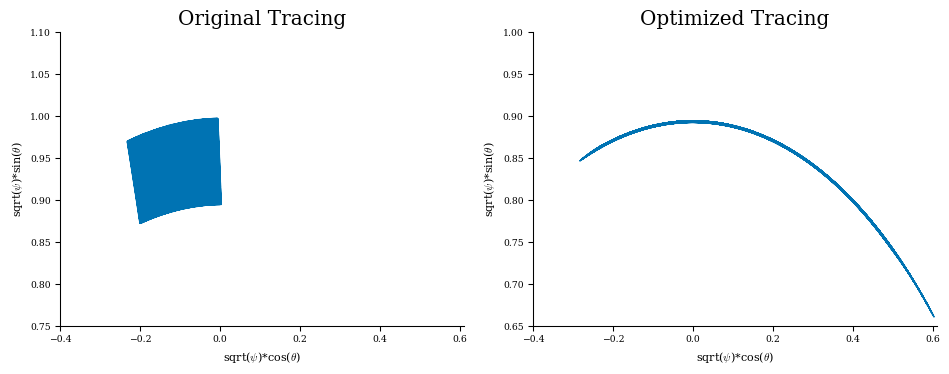

In [42]:
def import_file(file):
    # Define the file name where the data is stored
    file_name = file

    # Initialize empty lists to store the separated columns
    list1 = []
    list2 = []

    list3 = []
    list4 = []

    # Open the file for reading
    with open(file_name, 'r') as file:
        # Read the first line (column headers) and discard it
        file.readline()

        # Read the data row by row
        i = 0
        for line in file:
            # Split the line into columns using tab as the delimiter
            columns = line.strip().split('\t')

            # Convert each column to the appropriate data type and append to the respective lists
            list1.append(float(columns[0]))
            list2.append(float(columns[1]))
            list3.append(float(columns[2]))
            list4.append(float(columns[3]))

    return list1, list2, list3, list4

list1, list2, list3, list4 = import_file("tracing_original.txt")
list1_opt, list2_opt, list3_opt, list4_opt = import_file("tracing_optimized.txt")  

fig, ax = plt.subplots(1, 2, figsize=(10, 4))

ax[0].plot(np.sqrt(list1) * np.cos(list2), np.sqrt(list1) * np.sin(list2))
ax[1].plot(np.sqrt(list1_opt) * np.cos(list2_opt), np.sqrt(list1_opt) * np.sin(list2_opt))

# ax[0].set_aspect("equal", adjustable='box')
# ax[1].set_aspect("equal", adjustable='box')

ax[0].set_xlabel(r'sqrt($\psi$)*cos($\theta$)')
ax[0].set_ylabel(r'sqrt($\psi$)*sin($\theta$)')
ax[1].set_xlabel(r'sqrt($\psi$)*cos($\theta$)')
ax[1].set_ylabel(r'sqrt($\psi$)*sin($\theta$)')

ax[0].set_title("Original Tracing", fontsize=15)
ax[1].set_title("Optimized Tracing", fontsize=15)

ax[0].set_xlim(-0.4, 0.61)
ax[0].set_ylim(0.75, 1.10)
ax[1].set_xlim(-0.4, 0.61)
ax[1].set_ylim(0.65, 1)

plt.show()


Text(0, 0.5, 'sqrt($\\psi$)*sin($\\theta$)')

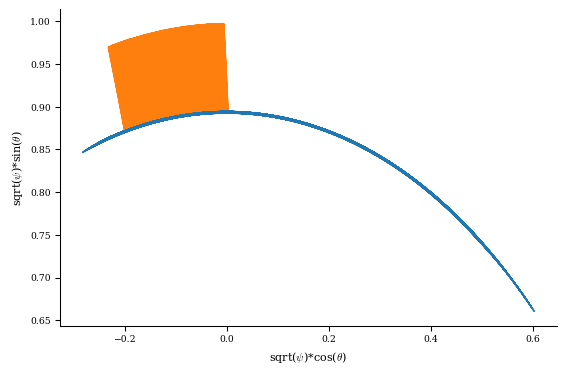

In [43]:
fig, ax = plt.subplots()

#create simple line plot

ax.plot(np.sqrt(list1[:]) * np.cos(list2[:]), np.sqrt(list1[:]) * np.sin(list2[:]), "tab:orange")
ax.plot(np.sqrt(list1_opt[:]) * np.cos(list2_opt[:]), np.sqrt(list1_opt[:]) * np.sin(list2_opt[:]), "tab:blue")

#set aspect ratio to 1
# ratio = 1.0
# x_left, x_right = ax.get_xlim()
# y_low, y_high = ax.get_ylim()
# ax.set_aspect("equal", adjustable='box')

plt.xlabel(r'sqrt($\psi$)*cos($\theta$)')
plt.ylabel(r'sqrt($\psi$)*sin($\theta$)')


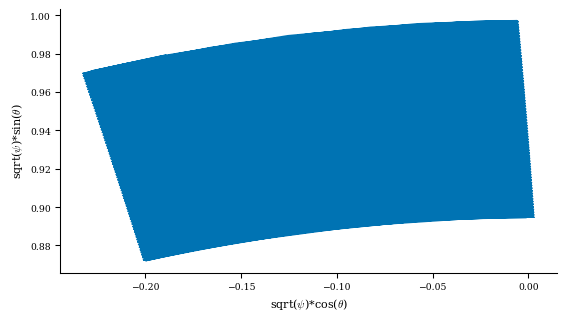

In [44]:
fig, ax = plt.subplots()

#create simple line plot

ax.plot(np.sqrt(list1) * np.cos(list2), np.sqrt(list1) * np.sin(list2))

#set aspect ratio to 1
ratio = 1.0
x_left, x_right = ax.get_xlim()
y_low, y_high = ax.get_ylim()
ax.set_aspect("equal", adjustable='box')

plt.xlabel(r'sqrt($\psi$)*cos($\theta$)')
plt.ylabel(r'sqrt($\psi$)*sin($\theta$)')

#plt.title(rf'E = {E_}, q/m = {q_}/{m_}, $\Delta$t = [{t_i}, {t_f}], nt = {nt_}, x$_i$ = [{psi_i:.2f}, {theta_i:.2f}, {zeta_i:.2f}], v$_\%$ = {vpar_i_ratio:.2f}')
plt.show()

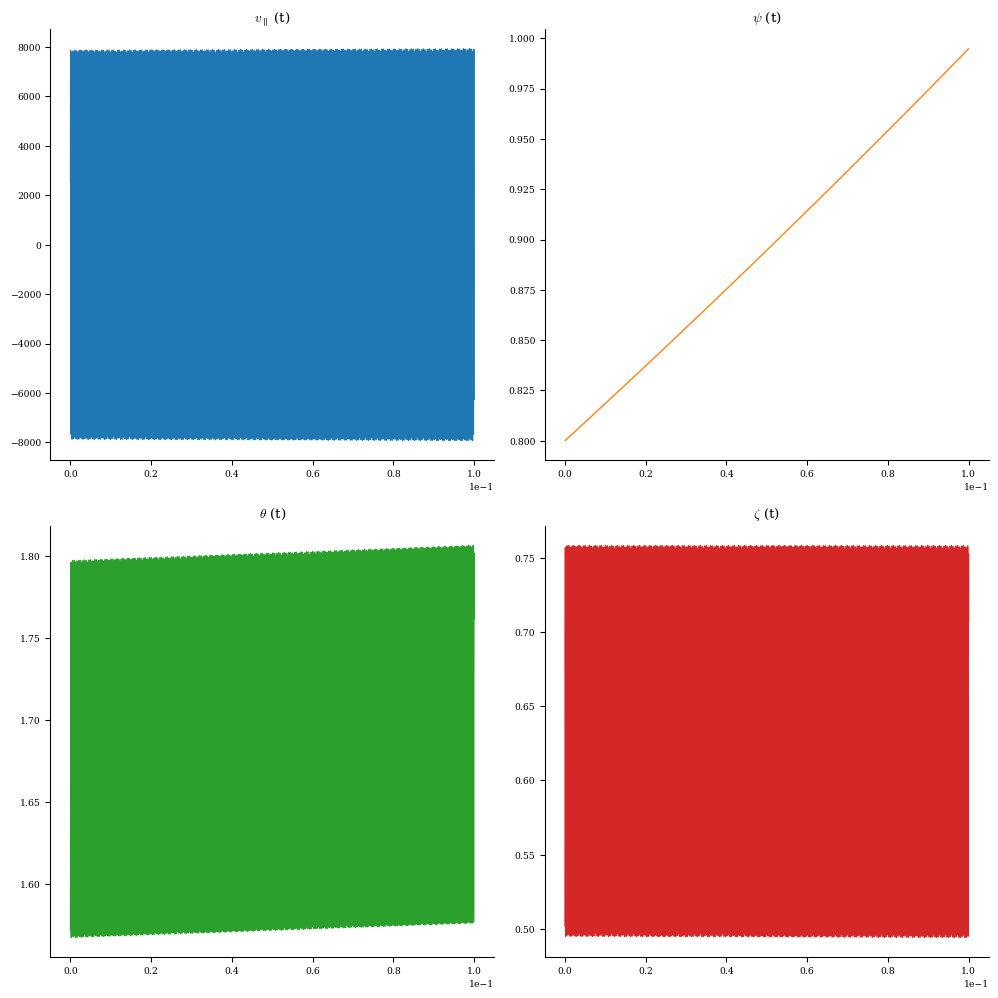

In [45]:
t = np.linspace(0, 0.1, 4999)

fig, axs = plt.subplots(2, 2)
axs[0, 1].plot(t, list1, 'tab:orange')
axs[0, 1].set_title(r'$\psi$ (t)')
axs[1, 0].plot(t, list2, 'tab:green')
axs[1, 0].set_title(r'$\theta$ (t)')
axs[1, 1].plot(t, list3, 'tab:red')
axs[1, 1].set_title(r'$\zeta$ (t)')
axs[0, 0].plot(t, list4, 'tab:blue')
axs[0, 0].set_title(r"$v_{\parallel}$ (t)")

fig = plt.gcf()
fig.set_size_inches(10.5, 10.5)
axs[0, 0].ticklabel_format(axis="x", style="sci", scilimits=(0,0))
axs[1, 0].ticklabel_format(axis="x", style="sci", scilimits=(0,0))
axs[1, 1].ticklabel_format(axis="x", style="sci", scilimits=(0,0))
axs[0, 1].ticklabel_format(axis="x", style="sci", scilimits=(0,0))

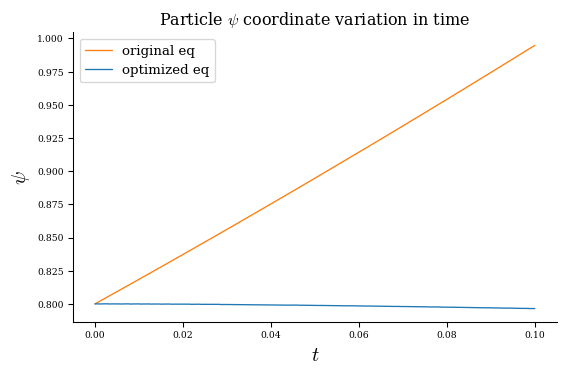

In [46]:
plt.plot(t, list1, 'tab:orange')
plt.plot(t, list1_opt, 'tab:blue')
plt.title(r"Particle $\psi$ coordinate variation in time", fontsize=12)
plt.xlabel(r"$t$", fontsize=15)
plt.ylabel(r"$\psi$", fontsize=15)
plt.legend(["original eq", "optimized eq"])


In [47]:
eq = desc.io.load("eq_2411_M1_N1.h5")
eq._iota = eq.get_profile("iota").to_powerseries(order=eq.L, sym=True)
eq._current = None

eq_opt = desc.io.load("optimized_eq_2411_M1_N1.h5")
eq_opt._iota = eq.get_profile("iota").to_powerseries(order=eq.L, sym=True)
eq_opt._current = None


In [48]:
for i in range(0, len(list1)):
    list1.append(list1[i] + 0.9947760884617463)
    list2.append(list2[i] + 1.761548205506244)
    list3.append(list3[i] + 0.7078330109535549)
    list4.append(list4[i] - 6276.648040834658)

In [49]:
grid = Grid(np.vstack((np.sqrt(list1), list2, list3)).T,sort=False)

data = eq.compute(["X", "Y", "Z"], grid)

grid_opt = Grid(np.vstack((np.sqrt(list1_opt), list2_opt, list3_opt)).T,sort=False)

data_opt = eq_opt.compute(["X", "Y", "Z"], grid_opt)

<Axes3D: >

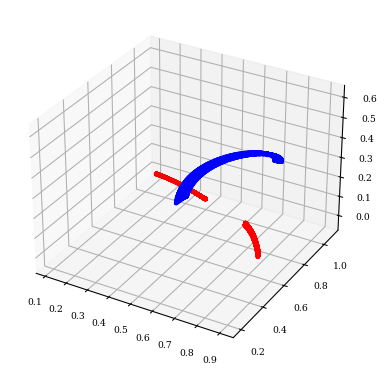

In [50]:
def plot_trajectory(data, ax=None, **kwargs):
    if ax is None:
        fig = plt.figure()
        ax = plt.figure().add_subplot(projection='3d')
    ax.scatter(data["X"], data["Y"], data["Z"], **kwargs)
    return ax

ax = plt.figure().add_subplot(projection='3d')
plot_trajectory(data, ax=ax, color="r", marker=".")
plot_trajectory(data_opt, ax=ax, color="b", marker=".")

In [51]:
grid = LinearGrid(rho=np.sqrt(0.8), M = 100, N = 100)
fig = plot_3d(eq, "B", alpha=0.3, grid=grid)
fig.add_trace(go.Scatter3d(x=data["X"], y=data["Y"], z=data["Z"], mode='markers', marker_size=2))
# fig.write_image("surface_and_tracing.png")


In [47]:
grid = LinearGrid(rho=np.sqrt(0.8), M = 100, N = 100)
fig = plot_3d(eq_opt, "B", alpha=0.3, grid=grid)
fig.add_trace(go.Scatter3d(x=data_opt["X"], y=data_opt["Y"], z=data_opt["Z"], mode='markers', marker_size=2))
# fig.write_image("surface_and_tracing.png")